
# Day 1: Introduction

We talked today about the massive transformation that electricity markets are witnessing, with the rapid growth of renewable power and explicity goal of fully decarbonizing the electricity market in coming years.

In this practice session, we will examine time series data from the Spanish electricity market, which has substantial intermittent renewable power (wind and solar), and study the effects of renewable expansion on economic and environmental indicators.

The data have been collected from publicly available sources (Red Eléctrica de España and OMIE, among others). The data are from the paper "Measuring the Impact of Wind Power in the Spanish Electricity Market," by Claire Petersen, Mar Reguant, and Lola Segura.

We need to load packages in Julia, similar to the import function in Python or the library functionality in R.

In [ ]:
#using Pkg
#Pkg.add(["Binscatters", "CSV", "DataFrames", "Statistics", "Plots", "FixedEffectModels", "RegressionTables"])

To **load the libraries**, we use the command `using`. 

Here we will be loading a bunch of libraries so that we can load and use the data (`DataFrames`, `CSV`), compute statistics and manipulate data (`Statistics`) and make some nice plots (`Plots`, `Binscatters`). We will also be running some fixed-effects regressions (`FixedEffectModels`).

In [2]:
using DataFrames
using CSV
using Binscatters
using Statistics
using Plots
using FixedEffectModels

We load the data using the CSV syntax (`CSV.read`) into a data frame called `df`. `first(df,5)` gives us a snapshot of the data. Make sure the data is in the same directory as the notebook or specify the full path name.

In [4]:
df = CSV.read("data_spain.csv", DataFrame)
df

,year,month,day,hour,dayofweek,demand,demand_forecast,wind,wind_forecast
,Int64,Int64,Int64,Int64,Int64,Float64?,Float64,Float64,Float64?
1,2009,5,1,1,5,25.337,25.021,5.7625,5.427
2,2009,5,1,2,5,23.478,23.044,5.7461,5.441
3,2009,5,1,3,5,21.859,21.685,5.786,5.487
4,2009,5,1,4,5,20.931,20.408,5.9837,5.532
5,2009,5,1,5,5,20.371,19.586,6.0831,5.551
6,2009,5,1,6,5,19.809,18.871,6.1295,5.597
7,2009,5,1,7,5,19.681,18.383,6.1246,5.637
8,2009,5,1,8,5,19.132,17.965,6.2554,5.799
9,2009,5,1,9,5,19.688,18.178,6.1949,6.089


## Summary Statistics

We start by displaying some statistics and plot hourly and yearly patterns of wind production and electricity demand.

Variables in Julia are defined by colons (:). eltype determines the type of the variable. Note that Julia differentiates between Integers (1) and Floating-Point (1.0)


In [5]:
describe(df)

,variable,mean,min,median,max,nmissing,eltype
,Symbol,Float64,Real,Float64,Real,Int64,Type
1,year,2013.39,2009,2013.0,2018,0,Int64
2,month,6.54388,1,7.0,12,0,Int64
3,day,15.7109,1,16.0,31,0,Int64
4,hour,12.4865,1,12.0,24,0,Int64
5,dayofweek,3.00334,0,3.0,6,0,Int64
6,demand,28.6556,17.096,28.827,43.588,24,"Union{Missing, Float64}"
7,demand_forecast,28.6898,14.38,28.853,43.568,0,Float64
8,wind,5.38397,0.1552,4.7899,17.4963,0,Float64
9,wind_forecast,5.29389,0.398,4.698,16.768,1,"Union{Missing, Float64}"


In order to plot hourly and yearly patterns, we first need to combine the data at those levels. For that, we first define the groups for which the functions will be applied using `groupby`. `combine` is then used to compute the specified summary statistic. Finally, we rename the variable as `wind_mean`.

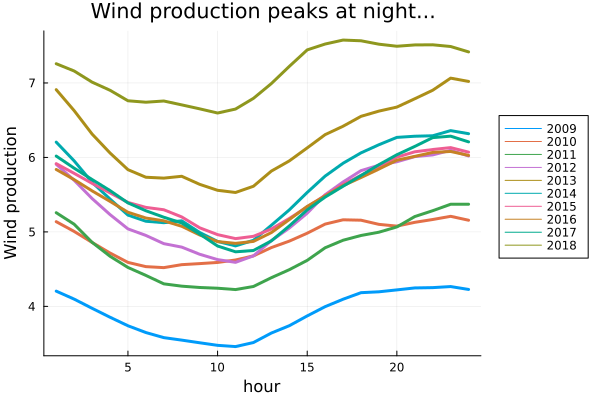

In [6]:
#compute the mean for each hour and year
df_mean = combine(groupby(df, ["hour", "year"]), :wind => mean => :wind_mean, 
    :demand => mean => :demand_mean);

plot(df_mean.hour, df_mean.wind_mean, group = df_mean.year,
	seriestype = :line, linewidth = 3,
	title = "Wind production peaks at night...",
    xlabel = "hour",
    ylabel = "Wind production",
    legend = :outerright)

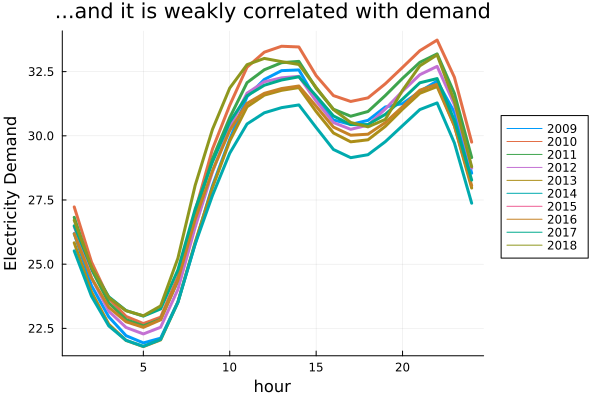

In [7]:
plot(df_mean.hour, df_mean.demand_mean, group = df_mean.year,
	seriestype = :line, linewidth = 3,
	title = "...and it is weakly correlated with demand",
    xlabel = "hour",
    ylabel = "Electricity Demand",
    legend = :outerright)

## The impacts of wind: a visual exploration

We will be plotting the **impacts of wind** on several outcomes of interest:
* Emissions
* Wholesale prices
* System costs
* Wholesale prices + system costs

We will be using the library `Binscatters` for plotting.

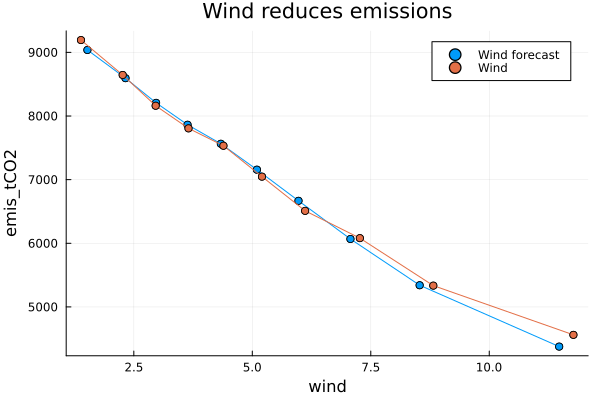

In [39]:
binscatter(df, @formula(emis_tCO2 ~ wind_forecast), 10, 
		seriestype = :scatterpath,
		title = "Wind reduces emissions",
		label = "Wind forecast",
		xlabel = "GWh",
		ylabel = "Hourly emissions (tons CO2)")
#we can add new specifications
#binscatter!(df, @formula(emis_tCO2 ~ wind), 10,seriestype = :scatterpath,
#label = "Wind")

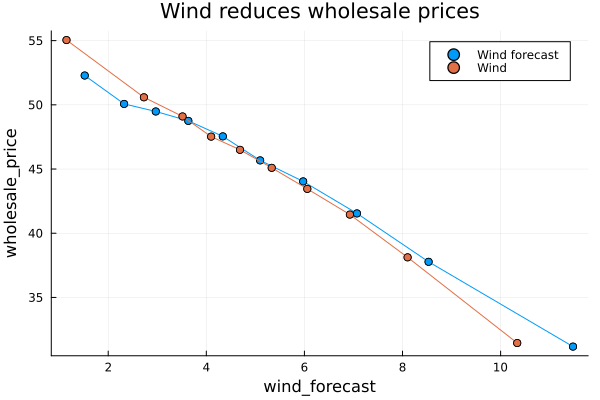

In [43]:
binscatter(df, @formula(wholesale_price ~ wind_forecast), 10, 
		seriestype = :scatterpath,
		title = "Wind reduces wholesale prices",
		label = "Wind forecast",
		xlabel = "GWh",
		ylabel = "Wholesale price (EUR/MWh)")
#we can add controls
binscatter!(df, @formula(wholesale_price ~ wind_forecast + demand_forecast + fe(year) 
			+ fe(month) + fe(hour)), 10,seriestype = :scatterpath,
			label = "Wind")

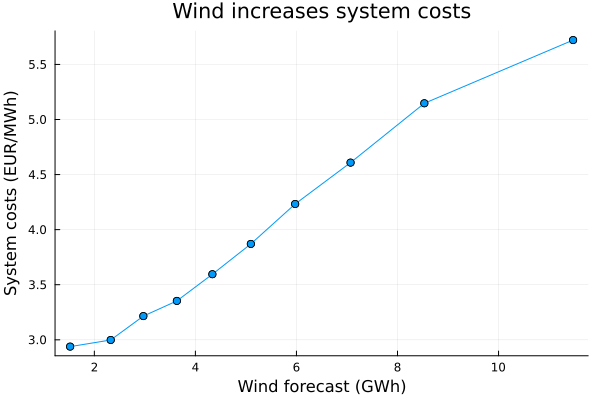

In [26]:
binscatter(df, @formula(system_costs ~ wind_forecast), 10, 
		seriestype = :scatterpath,
		title = "Wind increases system costs",
		xlabel = "Wind forecast (GWh)",
		ylabel = "System costs (EUR/MWh)")

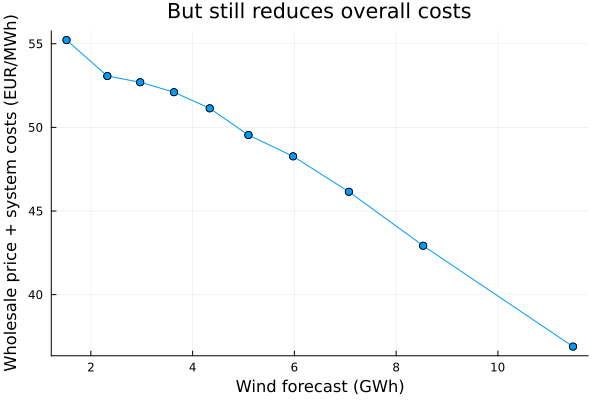

In [27]:
df.total_price = df.wholesale_price + df.system_costs
binscatter(df, @formula(total_price ~ wind_forecast), 10, 
	seriestype = :scatterpath,
	title = "But still reduces overall costs",
	xlabel = "Wind forecast (GWh)",
	ylabel = "Wholesale price + system costs (EUR/MWh)")

## Wind endogeneity

One can estimate the effects of wind using a regression framework. However, it is important to keep in mind that wind production can be endogenous.

In moments of very high forecasted wind, it is often the case that wind is discarded. This can create an endogeneity problem.

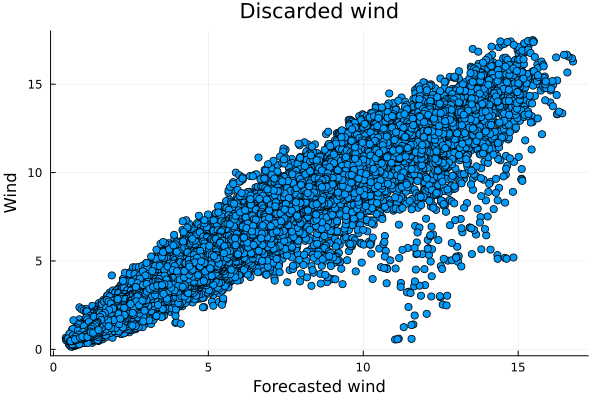

In [28]:
scatter(df.wind_forecast, df.wind, xlabel="Forecasted wind", ylabel="Wind", legend=false, title="Discarded wind")

We can examine the endogeneity problem in the context of assessing the impact of wind on reliability and other congestion costs ("system costs").

On days of very high wind, measured wind production could be lower than expected, leading to a downward bias in our estimates: a difficult day with lots of wind appears as a day with low levels of wind in the data.

To address this issue, one can use forecasted wind as an exogenous variable.

We will be running these regressions using the `FixedEffectModels` library.

In [29]:
reg_w = reg(df, @formula(system_costs ~ wind + fe(year) + fe(month)))

                          Fixed Effect Model                          
Number of obs:               78731   Degrees of freedom:             23
R2:                          0.228   R2 Adjusted:                 0.228
F-Stat:                    2762.59   p-value:                     0.000
R2 within:                   0.034   Iterations:                      6
system_costs | Estimate  Std.Error t value Pr(>|t|) Lower 95% Upper 95%
-----------------------------------------------------------------------
wind         | 0.187218 0.00356196 52.5603    0.000  0.180236  0.194199


In [30]:
reg_wf = reg(df, @formula(system_costs ~  wind_forecast + fe(year) + fe(month)))

                           Fixed Effect Model                           
Number of obs:                78730  Degrees of freedom:              23
R2:                           0.235  R2 Adjusted:                  0.235
F-Stat:                     3562.29  p-value:                      0.000
R2 within:                    0.043  Iterations:                       6
system_costs  | Estimate  Std.Error t value Pr(>|t|) Lower 95% Upper 95%
------------------------------------------------------------------------
wind_forecast | 0.224957 0.00376907 59.6849    0.000  0.217569  0.232344


Another possible problem is that system costs from wind production may be realized in hours with no wind. In this case, the hourly regression coefficient will be downward biased. To circumvent this issue, we can estimate the same regression at a daily level.

For that, we compute the total system costs as well as total wind power.

In [31]:
df.day_id = string.(df.year,df.month,df.day)
#In Julia, row-wise operations are defined with a dot.
	
df_day = combine(groupby(df, ["day_id","year","month"]), :wind_forecast => sum => :wind_forecast, :system_costs => sum => :system_costs);

In [32]:
reg_d = reg(df_day, @formula(system_costs ~  wind_forecast + fe(year) + fe(month)))

                          Fixed Effect Model                          
Number of obs:                3293   Degrees of freedom:             23
R2:                          0.507   R2 Adjusted:                 0.504
F-Stat:                    537.859   p-value:                     0.000
R2 within:                   0.141   Iterations:                      6
system_costs  | Estimate Std.Error t value Pr(>|t|) Lower 95% Upper 95%
-----------------------------------------------------------------------
wind_forecast | 0.255654 0.0110235 23.1918    0.000  0.234041  0.277268


We can display the output of our regressions using the `RegressionTables` package (similar to `stargazer` in R).

In [33]:
using RegressionTables

regtable(reg_w, reg_wf,reg_d, regression_statistics = [:nobs,:adjr2])


----------------------------------------------
                         system_costs         
                ------------------------------
                     (1)        (2)        (3)
----------------------------------------------
wind            0.187***                      
                 (0.004)                      
wind_forecast              0.225***   0.256***
                            (0.004)    (0.011)
----------------------------------------------
year                 Yes        Yes        Yes
month                Yes        Yes        Yes
----------------------------------------------
Estimator            OLS        OLS        OLS
----------------------------------------------
N                 78,731     78,730      3,293
Adjusted R2        0.228      0.235      0.504
----------------------------------------------




This package also allows you to generate Latex output:

In [ ]:
regtable(reg_w,reg_wf,reg_d; renderSettings = latexOutput())
# To create a Latex document with the table simply specify the name of the document:
# regtable(reg_w,reg_wf; renderSettings = latexOutput(table.tex))

## A policy change 

The paper explores the **role of market design** in affecting the value of wind. The market moved away from subsidies that are paid based on production to subsidies that are based on installed capacity (subject to minimum performance requirments).

In the wholesale market, this implies that renewables no longer have an incentive to produce when prices are very low, e.g., as in California or Texas, in which prices are often zero or negative. 

We will split the data in two to examine the change in the distribution of wholesale prices around the policy change.

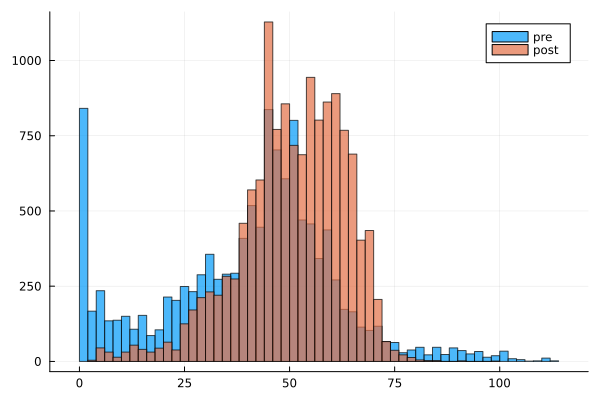

In [34]:
df.policy = (((df.year .> 2014) .| ((df.year.==2014) .& (df.month .> 5))));
df_policy = filter(row -> 2012 < row.year < 2016 ,df);
	
histogram(df_policy.wholesale_price, group = df_policy.policy, alpha = 0.7, label = ["pre" "post"])

The policy change appeared to reduce system costs in the market. This could be due to the challenges of dispatching the market in the presence of zero prices, which lead to several strategic distortions.

We can plot system costs before and after the change.

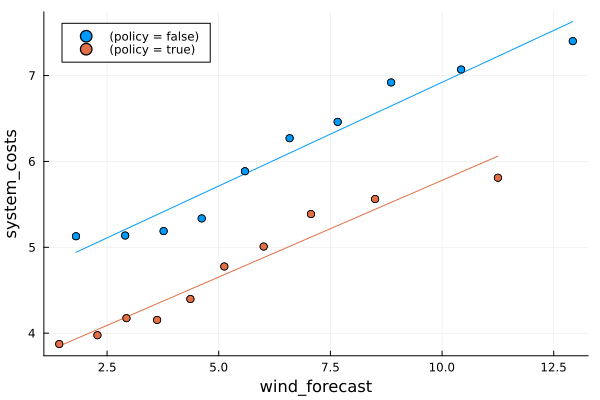

In [40]:
binscatter(groupby(df_policy, :policy), @formula(system_costs ~ wind_forecast), 10, 
	seriestype = :linearfit,
	legend = :topleft)

Consumers were still worse off due to the increase in prices. Wind price reduction effect diminished.

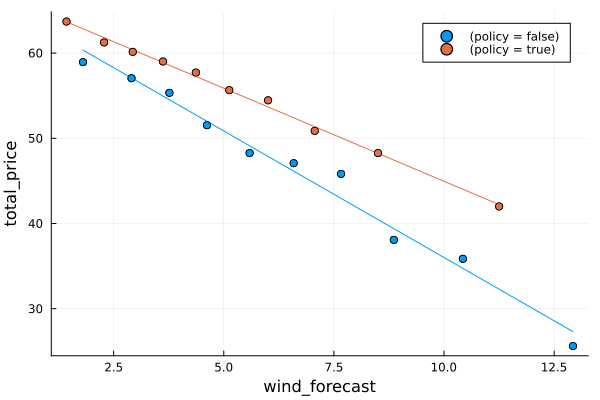

In [41]:
binscatter(groupby(df_policy, :policy), @formula(total_price ~ wind_forecast), 10, 
	seriestype = :linearfit,
	legend = :topright)

**Note:** This is an event study, so there are other changes happening in the market. The idea here is to show major effects of the policy, but proper quantification requires more explicit control of confounders. To start with, although not exhaustive, we can estimate the effect of wind forecast after the policy change.

In [42]:
reg(df, @formula(wholesale_price ~ wind_forecast*policy + demand_forecast + fe(hour) + fe(year) + fe(month)))

                                Fixed Effect Model                                
Number of obs:                     78730  Degrees of freedom:                   50
R2:                                0.706  R2 Adjusted:                       0.706
F-Stat:                          19798.9  p-value:                           0.000
R2 within:                         0.502  Iterations:                            7
wholesale_price        | Estimate  Std.Error  t value Pr(>|t|) Lower 95% Upper 95%
----------------------------------------------------------------------------------
wind_forecast          | -2.89202  0.0158909 -181.992    0.000  -2.92317  -2.86088
policy                 |   6.3441   0.235877  26.8958    0.000   5.88178   6.80642
demand_forecast        |  1.63373 0.00990177  164.994    0.000   1.61432   1.65314
wind_forecast & policy | 0.817855  0.0212392  38.5069    0.000  0.776226  0.859484


## Follow-up exercises

1. What is the correlation of wind and demand? How could that affect the valuation of wind power?

2. (*) What is the environmental benefit of wind power in this market per unit of wind? Try to quantify that by regressing emissions on wind and converting it to a monetary amount using a valuation for emissions reductions. 
Estimate the total welfare effects of wind production. For that, you need to add to the environmental benefit the consumer and producer surplus. With respect to the producer surplus assume that the LCOE ranges between 50 to 90 €/MWh. How does your answer depend on the monetary value of reducing emissions?